6132 Курицын Никита  
Лабораторная работа №2: Визуализация данных

In [2]:
import pandas as pd

In [3]:
data = pd.read_csv('star_classification.csv')# считываем с помощью метода read_csv и помещяем данные в data

2. Привести описание датасета.

In [4]:
description_list = [
"Идентификатор объекта, уникальное значение, определяющее объект в каталоге изображений, используемом CAS",
 "Прямое восхождение (на эпоху J2000)",
 "Склонение (на эпоху J2000)",
 "Ультрафиолетовый фильтр в фотометрической системе",
 "Зеленый фильтр в фотометрической системе",
 "Красный фильтр в фотометрической системе",
 "Ближний инфракрасный фильтр в фотометрической системе",
 "Инфракрасный фильтр в фотометрической системе",
 "Номер прогона, используемый для идентификации конкретного сканирования",
 "Номер повторного прогона, указывающий, как было обработано изображение",
 "Номер камеры для идентификации линии сканирования внутри прогона",
 "Номер поля для идентификации каждого поля",
 "Уникальный идентификатор, используемый для оптических спектроскопических объектов (это означает, что 2 разных наблюдения с одним и тем же spec_obj_ID должны иметь одинаковый класс вывода)",
 "Класс объекта (галактика, звезда или квазарный объект)",
 "Красное смещение на основе увеличения длины волны",
 "Идентификатор пластины, идентифицирующий каждую пластину в SDSS",
 "Измененная юлианская дата, используемая для указания времени съемки конкретных данных SDSS",
 "Идентификатор волокна, определяющий волокно, направившее свет на фокальную плоскость в каждом наблюдении"
]
dtypes_column = data.dtypes
df_info = pd.DataFrame({'Тип': dtypes_column, 'Описание': description_list})
pd.set_option('display.max_colwidth', None)
df_info

,Тип,Описание
obj_ID,float64,"Идентификатор объекта, уникальное значение, определяющее объект в каталоге изображений, используемом CAS"
alpha,float64,Прямое восхождение (на эпоху J2000)
delta,float64,Склонение (на эпоху J2000)
u,float64,Ультрафиолетовый фильтр в фотометрической системе
g,float64,Зеленый фильтр в фотометрической системе
r,float64,Красный фильтр в фотометрической системе
i,float64,Ближний инфракрасный фильтр в фотометрической системе
z,float64,Инфракрасный фильтр в фотометрической системе
run_ID,int64,"Номер прогона, используемый для идентификации конкретного сканирования"
rerun_ID,int64,"Номер повторного прогона, указывающий, как было обработано изображение"


In [5]:
data.head(3)# выводим первые 3 записи

,obj_ID,alpha,delta,u,g,r,i,z,run_ID,rerun_ID,cam_col,field_ID,spec_obj_ID,class,redshift,plate,MJD,fiber_ID
0,1.237661e+18,135.689107,32.494632,23.87882,22.27530,20.39501,19.16573,18.79371,3606,301,2,79,6.543777e+18,GALAXY,0.634794,5812,56354,171
1,1.237665e+18,144.826101,31.274185,24.77759,22.83188,22.58444,21.16812,21.61427,4518,301,5,119,1.176014e+19,GALAXY,0.779136,10445,58158,427
2,1.237661e+18,142.188790,35.582444,25.26307,22.66389,20.60976,19.34857,18.94827,3606,301,2,120,5.152200e+18,GALAXY,0.644195,4576,55592,299


In [6]:
data['field_ID'].value_counts()# Подсчитываем количество вхождений каждого значения в столбце 'field_ID'

field_ID
71     472
65     458
67     449
60     448
69     447
      ... 
748      1
977      1
979      1
974      1
934      1
Name: count, Length: 856, dtype: int64

3. `matplotlib`:  
   - Построить несколько графиков разного вида с использованием `matplotlib`.  
   - Построить несколько суб-графиков на одном графике используя `.subplot`.  
   - Построить интерактивный график со слайдером.
   
   > - Графики должны быть разных видов.  
   > - Хотя бы в одном графике необходимо подписать оси.  
   > - Во всех графиках необходимо указать название.
   > - Необязательно строить сложный и перегруженный информацией интерактивный график, достаточно одного-двух числовых признаков в разрезе другого признака, как минимум добавить слайдер (ползунок). Наличие других графических элементов управления (кнопки и т.п.) - опционально.

In [7]:
import matplotlib.pyplot as plt#импорт

Строим гистограмму alpha

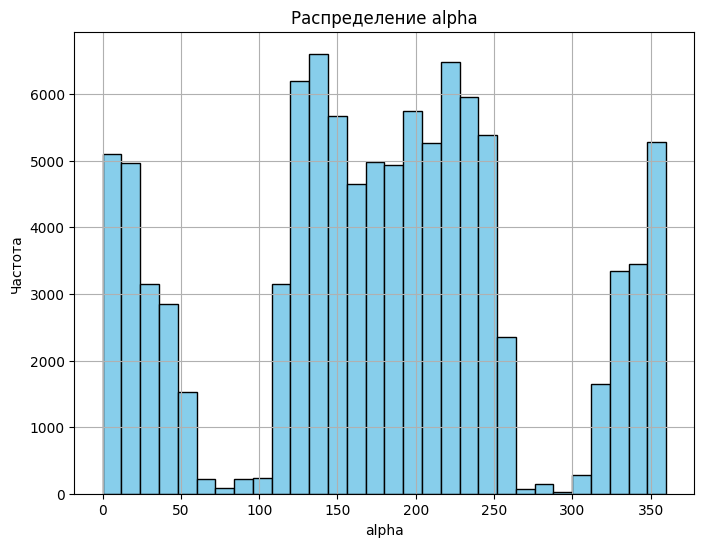

In [8]:
ra_values = data['alpha']
plt.figure(figsize=(8, 6))
plt.hist(ra_values, bins=30, color='skyblue', edgecolor='black')
plt.title('Распределение alpha')
plt.xlabel('alpha')
plt.ylabel('Частота')
plt.grid(True)

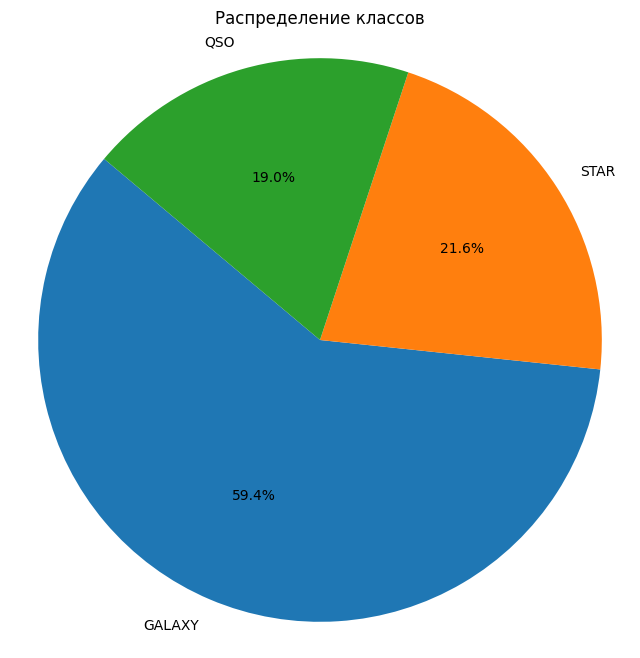

In [9]:
category_counts = data['class'].value_counts()
plt.figure(figsize=(8, 8))
plt.pie(category_counts, labels=category_counts.index, autopct='%1.1f%%', startangle=140)
plt.title('Распределение классов')
plt.axis('equal')  
plt.show()

Построить несколько суб-графиков на одном графике используя .subplot.

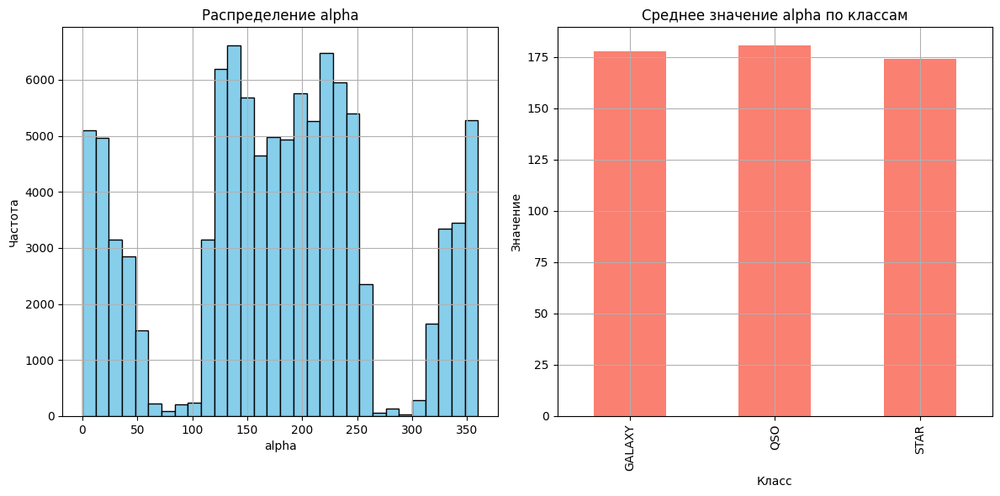

In [10]:
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(12, 6))

axes[0].hist(ra_values, bins=30, color='skyblue', edgecolor='black')
axes[0].set_title('Распределение alpha')
axes[0].set_xlabel('alpha')
axes[0].set_ylabel('Частота')
axes[0].grid(True)

mean_value_by_category = data.groupby('class')['alpha'].mean()
mean_value_by_category.plot(kind='bar', ax=axes[1], color='salmon')
axes[1].set_title('Среднее значение alpha по классам')
axes[1].set_xlabel('Класс')
axes[1].set_ylabel('Значение')
axes[1].grid(True)

plt.tight_layout()

plt.show()

In [11]:
import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objects as go
from plotly.offline import iplot, init_notebook_mode
init_notebook_mode(connected=True)

Построить интерактивный график со слайдером.

In [12]:
grouped_data = data.groupby('class') \
    .agg({'cam_col' : 'count'
          }) \
    .reset_index()# подсчитываем по классам кол-во элементов cam_col
numbers_col = ['cam_col_1_count', 'cam_col_2_count',
           'cam_col_3_count', 'cam_col_4_count','cam_col_5_count',
           'cam_col_6_count']# название столбцов

In [13]:
grouped_data

,class,cam_col
0,GALAXY,59445
1,QSO,18961
2,STAR,21594


In [14]:
for index,numbers in enumerate(numbers_col):
    grouped_data[numbers] = data[data['cam_col'] == index + 1].groupby('class').size().reset_index(drop=True)# создаем новые столбцы, по элементам
    grouped_data[numbers] = grouped_data[numbers] / grouped_data['cam_col'] * 100 # переводим в проценты 

In [15]:
grouped_data

,class,cam_col,cam_col_1_count,cam_col_2_count,cam_col_3_count,cam_col_4_count,cam_col_5_count,cam_col_6_count
0,GALAXY,59445,13.762301,16.728068,18.780385,20.203549,19.062999,11.462697
1,QSO,18961,12.188176,17.425241,20.811139,18.321818,18.031749,13.221876
2,STAR,21594,12.665555,17.917014,17.324257,18.935816,17.532648,15.624711


In [16]:
%matplotlib inline
%matplotlib widget
from ipywidgets import *
import matplotlib as mpl
import matplotlib.cm as cm
import matplotlib.pyplot as plt
from itertools import cycle

from matplotlib.widgets import Slider, Button

interactive(children=(IntSlider(value=3, description='class_index', max=6, min=1), Output()), _dom_classes=('w…

<function __main__.update(class_index)>

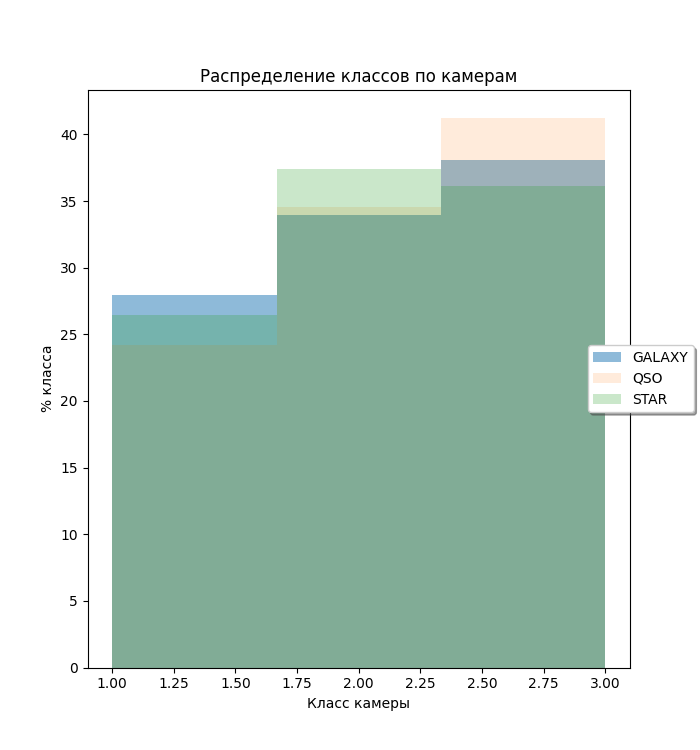

In [17]:
fig, ax = plt.subplots(figsize=(7, 7.5))

r_GALAXY, _, _ = ax.hist(range(1, 7), bins=6, weights=list(grouped_data.iloc[0, -6:]), label='GALAXY', alpha=0.5)
r_QSO, _, _ = ax.hist(range(1, 7), bins=6, weights=list(grouped_data.iloc[1, -6:]), label='QSO', alpha=0.15)
r_STAR, _, _ = ax.hist(range(1, 7), bins=6, weights=list(grouped_data.iloc[2, -6:]), label='STAR', alpha=0.25)

plt.xlabel("Класс камеры")
plt.ylabel("% класса")
plt.title("Распределение классов по камерам")
leg = ax.legend(loc ='right', bbox_to_anchor = (1.13, 0.5), fancybox=True, shadow=True)

def update(class_index):
    ax.clear()
    df_copy = data.copy()
    df_copy = df_copy[df_copy['cam_col']<=class_index]
    grouped_data = df_copy.groupby('class') \
    .agg({'cam_col' : 'count'
          }) \
    .reset_index()
    
    for index in range(class_index):
        grouped_data[numbers_col[index]] = data[data['cam_col'] == index + 1].groupby('class').size().reset_index(drop=True)
        grouped_data[numbers_col[index]] = grouped_data[numbers_col[index]] / grouped_data['cam_col'] * 100
    print(grouped_data)
    r_GALAXY, _, _ = ax.hist(range(1, class_index+1), bins=class_index, weights=list(grouped_data.iloc[0, -class_index:]), label='GALAXY', alpha=0.5)
    r_QSO, _, _ = ax.hist(range(1, class_index+1), bins=class_index, weights=list(grouped_data.iloc[1, -class_index:]), label='QSO', alpha=0.15)
    r_STAR, _, _ = ax.hist(range(1, class_index+1), bins=class_index, weights=list(grouped_data.iloc[2, -class_index:]), label='STAR', alpha=0.25)
    
    plt.xlabel("Класс камеры")
    plt.ylabel("% класса")
    plt.title("Распределение классов по камерам")
    leg = ax.legend(loc ='right', bbox_to_anchor = (1.13, 0.5), fancybox=True, shadow=True)
        

# Create slider
interact(update, class_index=(1, 6, 1))


4. `pandas`:  
   - Построить три разных вида графиков с использованием `pandas.DataFrame.plot` / `Series.plot`.  
   
   > - Среди графиков должен присутствовать один `boxplot` (обязательно надо использовать параметр `by`, для исследования взаимосвязи числовой переменной и какой-либо другой).  
   > - Графики должны быть построены как через методы `DataFrame`, так и через методы `Series`. То есть оба варианта нужно продемонстрировать.  

array([[<Axes: title={'center': 'cam_col'}>,
        <Axes: title={'center': 'cam_col_1_count'}>,
        <Axes: title={'center': 'cam_col_2_count'}>],
       [<Axes: title={'center': 'cam_col_3_count'}>,
        <Axes: title={'center': 'cam_col_4_count'}>,
        <Axes: title={'center': 'cam_col_5_count'}>],
       [<Axes: title={'center': 'cam_col_6_count'}>, <Axes: >, <Axes: >]],
      dtype=object)

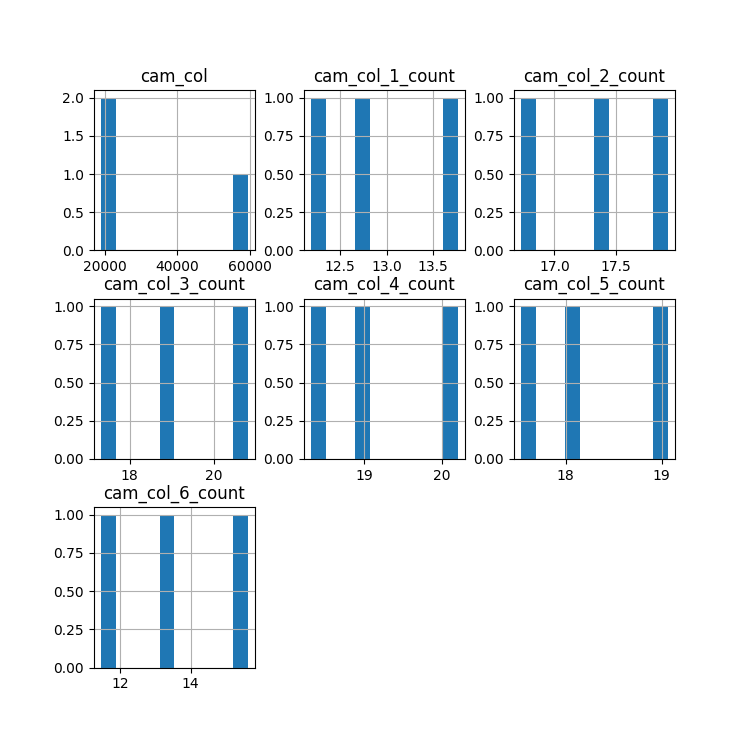

In [18]:
grouped_data.hist(figsize = (7.5,7.5))

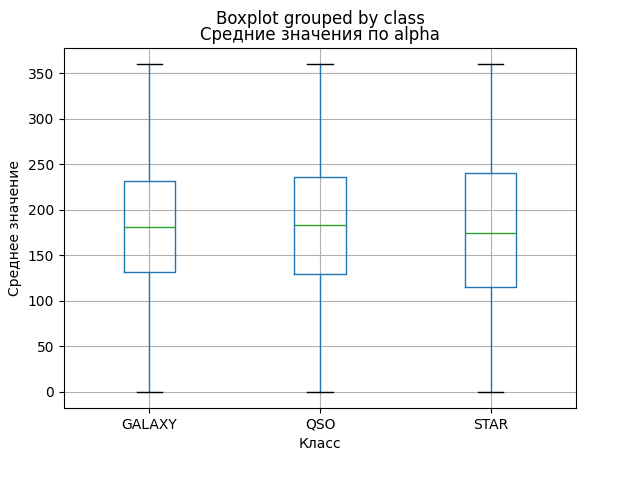

In [19]:
data.boxplot(column='alpha', by='class')
plt.title('Средние значения по alpha')
plt.xlabel('Класс')
plt.ylabel('Среднее значение')
plt.show()

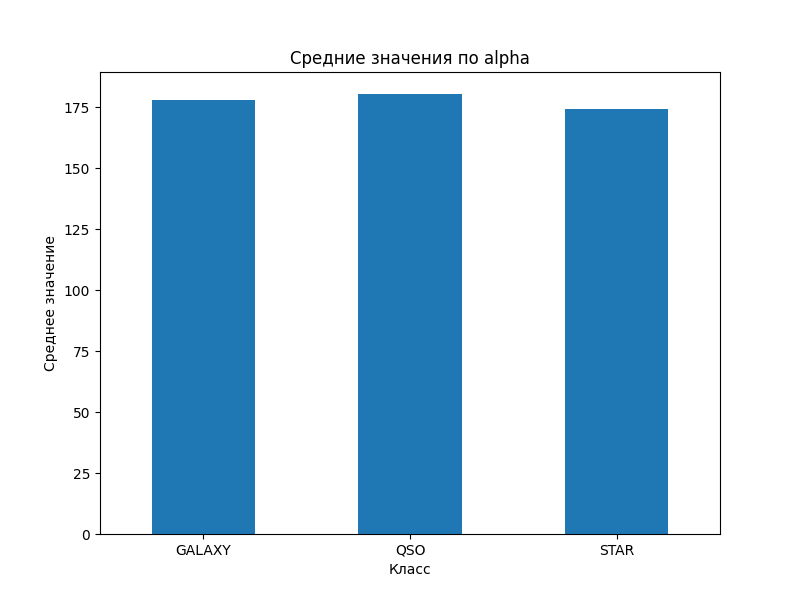

In [20]:
plt.figure(figsize=(8, 6))
data_grouped = data.groupby('class')['alpha'].mean()
data_grouped.plot(kind='bar', title='Средние значения по alpha', rot=0)
plt.xlabel('Класс')
plt.ylabel('Среднее значение')
plt.show()

5. `seaborn`:  
   - Построить `.pairplot` на каком-либо наборе данных, проанализировать взаимосвязь набора числовых признаков.  
   - Построить `.jointplot`, проанализировать взаимосвязь двух конкретных числовых признаков.  
   - Построить `.boxplot` и/или `.violinplot` на каком-либо наборе данных, проанализировать числовой признак в разрезе категориального.  
   - Построить график `.heatmap` попарной корреляции всех числовых признаков.  
   
     > Категориальные признаки необходимо убрать из датафрейма перед построением.  

In [21]:
import seaborn as sns

In [22]:
data_seab = data.iloc[:100,:5] # берем первые 100 строк и 5 признаков

In [23]:
data_seab

,obj_ID,alpha,delta,u,g
0,1.237661e+18,135.689107,32.494632,23.87882,22.27530
1,1.237665e+18,144.826101,31.274185,24.77759,22.83188
2,1.237661e+18,142.188790,35.582444,25.26307,22.66389
3,1.237663e+18,338.741038,-0.402828,22.13682,23.77656
4,1.237680e+18,345.282593,21.183866,19.43718,17.58028
...,...,...,...,...,...
95,1.237666e+18,348.335815,25.685581,23.93912,22.92743
96,1.237671e+18,42.048515,32.466019,21.80150,18.61152
97,1.237662e+18,169.417236,7.719850,25.08139,22.03635
98,1.237662e+18,243.498908,4.309792,21.23949,20.39086


Построить .pairplot на каком-либо наборе данных, проанализировать взаимосвязь набора числовых признаков.

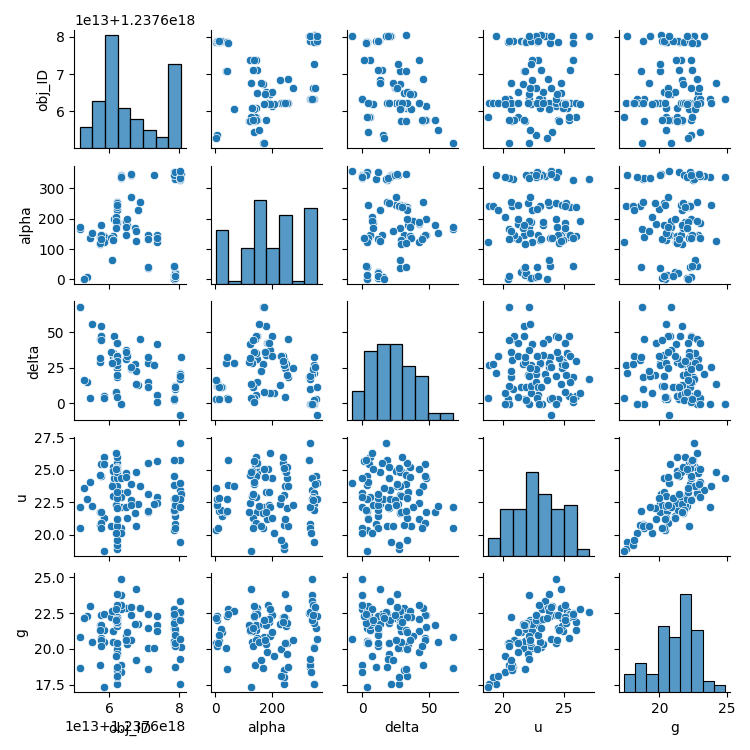

In [24]:
sns.pairplot(data_seab,height=1.5)

Построить .jointplot, проанализировать взаимосвязь двух конкретных числовых признаков.

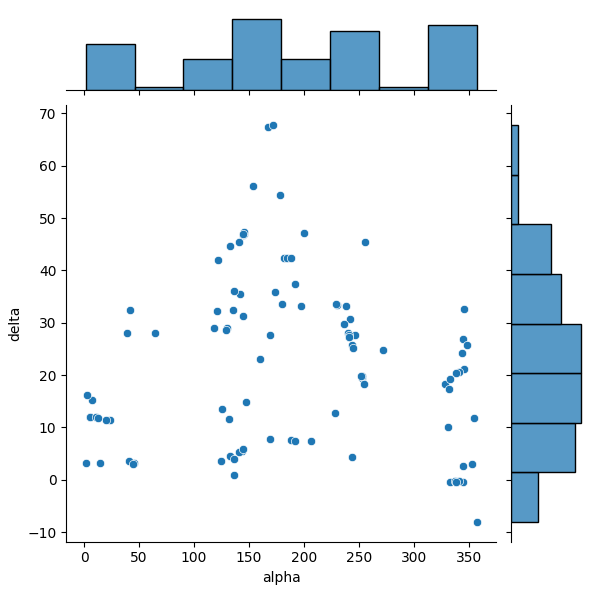

In [25]:
sns.jointplot(x='alpha', y='delta', data=data_seab, kind='scatter') # по delta и alpha

Построить .boxplot и/или .violinplot на каком-либо наборе данных, проанализировать числовой признак в разрезе категориального.

<Axes: xlabel='class', ylabel='alpha'>

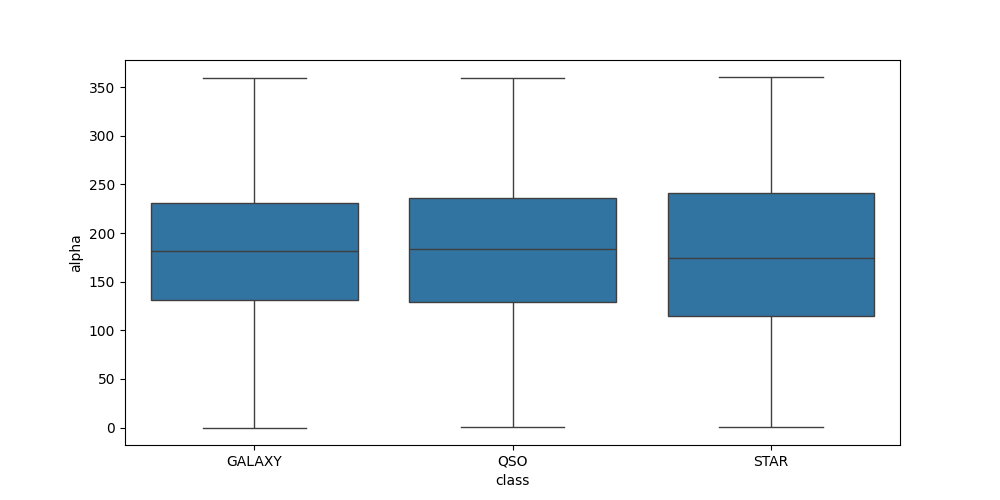

In [26]:
plt.figure(figsize=(10, 5))
sns.boxplot(x='class', y='alpha', data=data)

Построить график .heatmap попарной корреляции всех числовых признаков.

In [27]:
numerical_data = data.select_dtypes(include=['float64']) # выбираем только числовые признаки

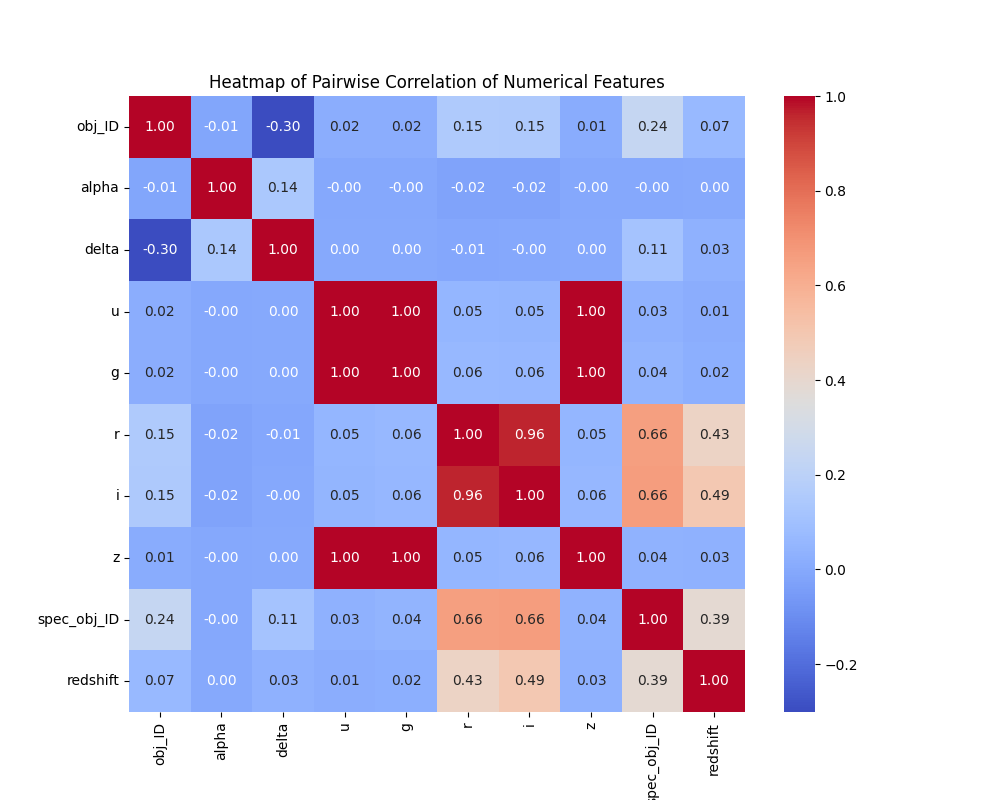

In [28]:
correlation_matrix = numerical_data.corr()
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f", square=True)
plt.title('Heatmap of Pairwise Correlation of Numerical Features')
plt.show()

6. `scipy.stats`:  
   - Построить QQ-график (и гистограмму) для одного из числовых признаков с целью проверки на соответствие его распределения нормальному распределению. 

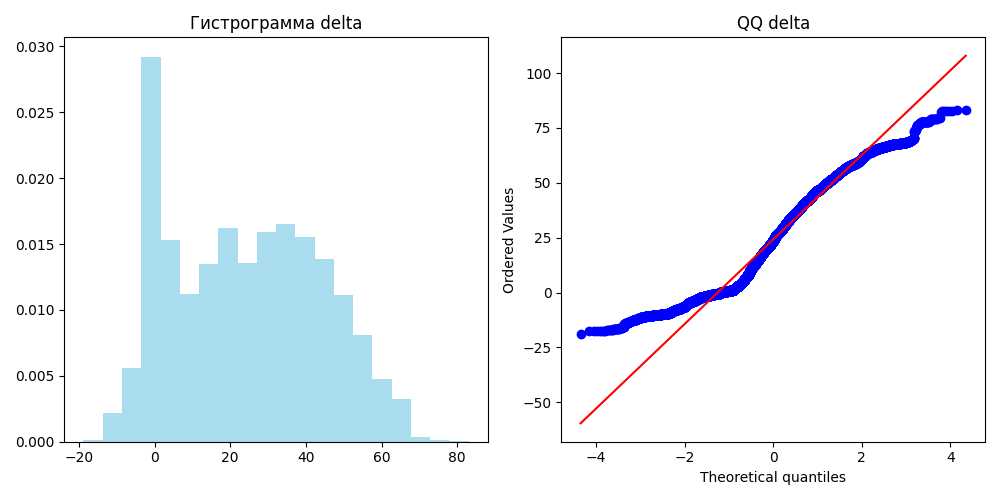

In [29]:
import scipy.stats as stats
feature = numerical_data['delta']

plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.hist(feature, bins=20, density=True, color='skyblue', alpha=0.7)
plt.title('Гистрограмма delta')


plt.subplot(1, 2, 2)
stats.probplot(feature, dist="norm", plot=plt)
plt.title('QQ delta')

plt.tight_layout()
plt.show()

7. `plotly`:  
   - Построить несколько графиков разного вида.  
   - Построить несколько суб-графиков на одном графике.  
   - Построить интерактивный график.  

In [30]:
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots

In [31]:
numerical_data.columns

Index(['obj_ID', 'alpha', 'delta', 'u', 'g', 'r', 'i', 'z', 'spec_obj_ID',
       'redshift'],
      dtype='object')

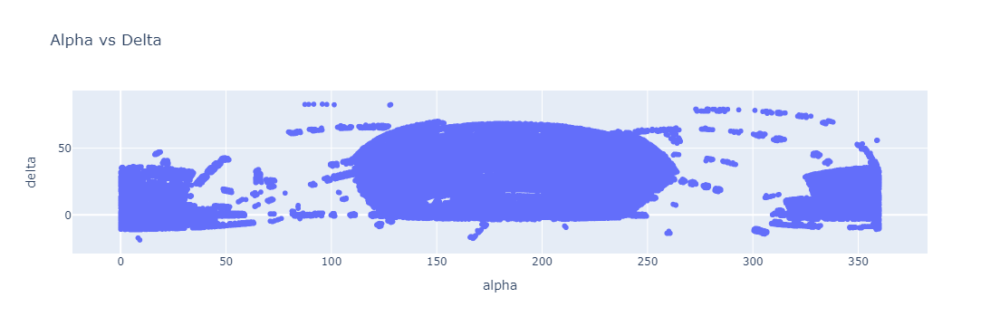

In [32]:
scatter_fig = px.scatter(data_frame=numerical_data, x='alpha', y='delta', title='Alpha vs Delta')
scatter_fig.show()

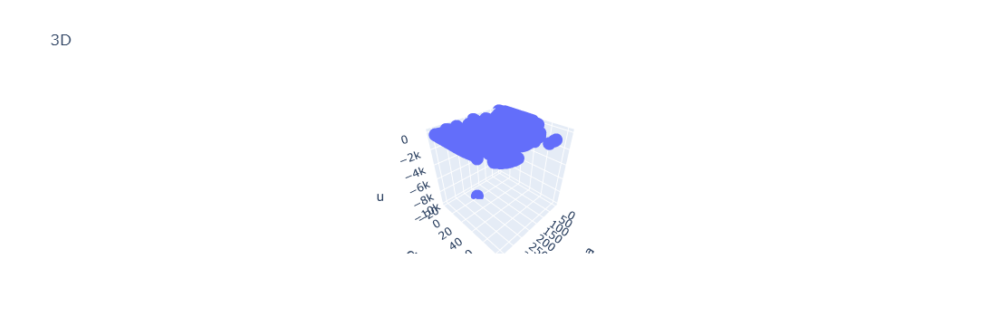

In [33]:
fig = go.Figure(data=[go.Scatter3d(x=numerical_data['alpha'], y=numerical_data['delta'], z=numerical_data['u'], mode='markers')])
fig.update_layout(scene=dict(xaxis_title='alpha', yaxis_title='delta', zaxis_title='u'), title='3D')
fig.show()

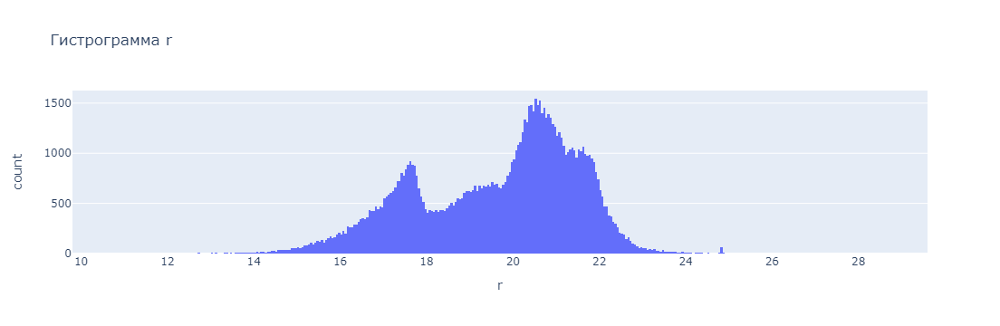

In [34]:
hist_fig = px.histogram(data_frame=numerical_data, x='r', title='Гистрограмма r')
hist_fig.show()

Построить несколько суб-графиков на одном графике.

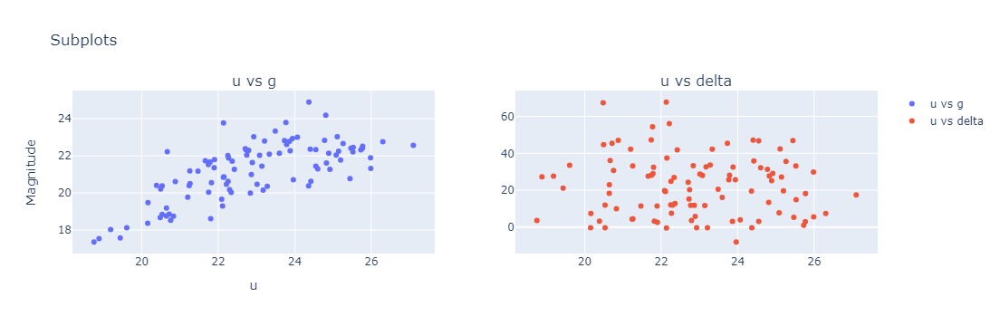

In [35]:

fig = make_subplots(rows=1, cols=2, subplot_titles=('u vs g', 'u vs delta'))

# Добавление графиков рассеяния на субграфики
fig.add_trace(go.Scatter(x=data_seab['u'], y=data_seab['g'], mode='markers', name='u vs g'), row=1, col=1)
fig.add_trace(go.Scatter(x=data_seab['u'], y=data_seab['delta'], mode='markers', name='u vs delta'), row=1, col=2)


# Установка заголовка и меток осей
fig.update_layout(title='Subplots',
                  xaxis=dict(title='u'),
                  yaxis=dict(title='Magnitude'))

# Отображение графика
fig.show()

Построить интерактивный график.

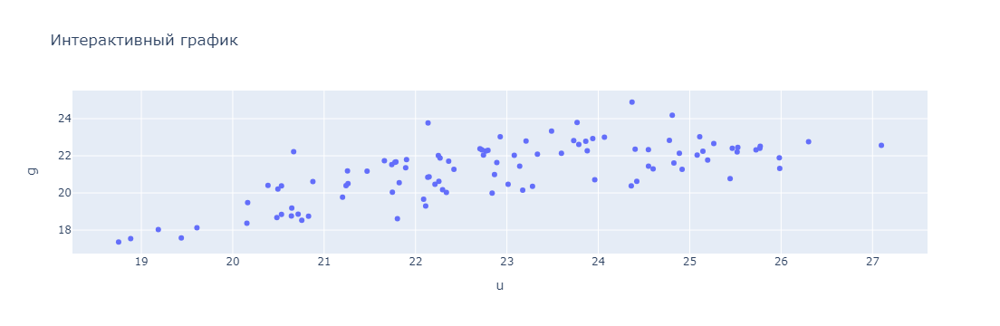

In [36]:
scatter_fig = px.scatter(data_frame=data_seab, x='u', y='g', title='Интерактивный график', hover_name='obj_ID')
scatter_fig.show()